<a href="https://colab.research.google.com/github/Page0526/Pytorch-crash-course/blob/main/deep-neural-networks/AutoEncoder.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# A Simple AutoEncoder and Latent Space Visualization with PyTorch

Ý tưởng của AutoEncoder là encode input dưới latent space xong đó decode ra output (reconstructed image) gần giống với input. Ở đấy input sẽ được encoder như 1 điểm duy nhất (khác với VAE encode input as a distribution)

## Preliminaries

In [4]:
!pip install torchvision torchsummary

In [5]:
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import DataLoader

# torchsummary for easy checking and debugging
from torchsummary import summary
# torchvision for downloading and processing data
import torchvision
from torchvision import transforms
from torchvision.datasets import FashionMNIST
# Other for notebook UI and latent space visualization
from PIL import Image
from tqdm.notebook import tqdm
import numpy as np
import matplotlib.pyplot as plt

In [6]:
# Checking if CUDA is available on current machine
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f'Deivce: {DEVICE}')

BATCH_SIZE = 64
EPOCHS = 3
lr = 5e-4

Deivce: cuda


## Loading FashionMNIST Dataset

In [7]:
def collate_fn(batch):
  '''
  Convert datasets from PIL Image to torch tensor, and padding 2 pixels on each side
  '''
  process = transforms.Compose([
      transforms.ToTensor(),
      transforms.Pad([2])
  ])
  # x - images, process each images in the batch
  x = [process(data[0]) for data in batch]
  # torch.concat(tensors, dim=0,*,out=None): concatenates given seq tensors (List of Tensors) in the given dim
  '''
  Eg:
    x = torch.rand(2, 3):
    tensor([[ 0.6580, -1.0969, -0.4614],
          [-0.1034, -0.5790,  0.1497]])
    x = torch.concat((x, x, x), dim=0)
    tensor([[ 0.6580, -1.0969, -0.4614],
          [-0.1034, -0.5790,  0.1497],
          [ 0.6580, -1.0969, -0.4614],
          [-0.1034, -0.5790,  0.1497],
          [ 0.6580, -1.0969, -0.4614],
          [-0.1034, -0.5790,  0.1497]])
    x = torch.concat(x)
    tensor([[ 0.6580, -1.0969, -0.4614],
          [-0.1034, -0.5790,  0.1497],
          [ 0.6580, -1.0969, -0.4614],
          [-0.1034, -0.5790,  0.1497]])
  '''
  x = torch.concat(x).unsqueeze(1)
  # y - labels
  y = torch.LongTensor([data[1] for data in batch])
  return x, y

In [8]:
labels = ["T-shirt/top",
	          "Trouser",
	          "Pullover",
	          "Dress",
	          "Coat",
	          "Sandla",
	          "Shirt",
	          "Sneaker",
	          "Bag",
	          "Ankle boot"]

In [9]:
# download/load datase
train_data = FashionMNIST("./MNIST_DATA",train=True, download=True)
valid_data = FashionMNIST("./MNIST_DATA",train=False, download=True)

# put datasets into DataLoader
train_loader = DataLoader(train_data, batch_size=BATCH_SIZE, shuffle=True, collate_fn=collate_fn)
valid_loader = DataLoader(valid_data, batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_fn)

100%|██████████| 26421880/26421880 [00:02<00:00, 11610929.28it/s]


Extracting ./MNIST_DATA/FashionMNIST/raw/train-images-idx3-ubyte.gz to ./MNIST_DATA/FashionMNIST/raw



100%|██████████| 29515/29515 [00:00<00:00, 210881.60it/s]


Extracting ./MNIST_DATA/FashionMNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST_DATA/FashionMNIST/raw



100%|██████████| 4422102/4422102 [00:06<00:00, 715275.66it/s] 


Extracting ./MNIST_DATA/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST_DATA/FashionMNIST/raw



100%|██████████| 5148/5148 [00:00<00:00, 13345041.40it/s]

Extracting ./MNIST_DATA/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST_DATA/FashionMNIST/raw



Batch shape:  torch.Size([64, 1, 32, 32])


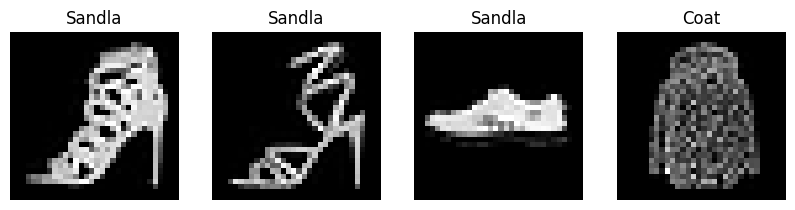

In [10]:
# Visualize data
for _, data in enumerate(train_loader):
  print("Batch shape: ",data[0].shape)
  fig, ax = plt.subplots(1, 4, figsize=(10, 4))

  for i in range(4):
    # Turn 3D tensor to 2D tensor due to image's single channel
    ax[i].imshow(data[0][i].squeeze(), cmap='gray')
    ax[i].axis("off")
    ax[i].set_title(labels[data[1][i]])

  plt.show()
  break

## AutoEncoder Architecture
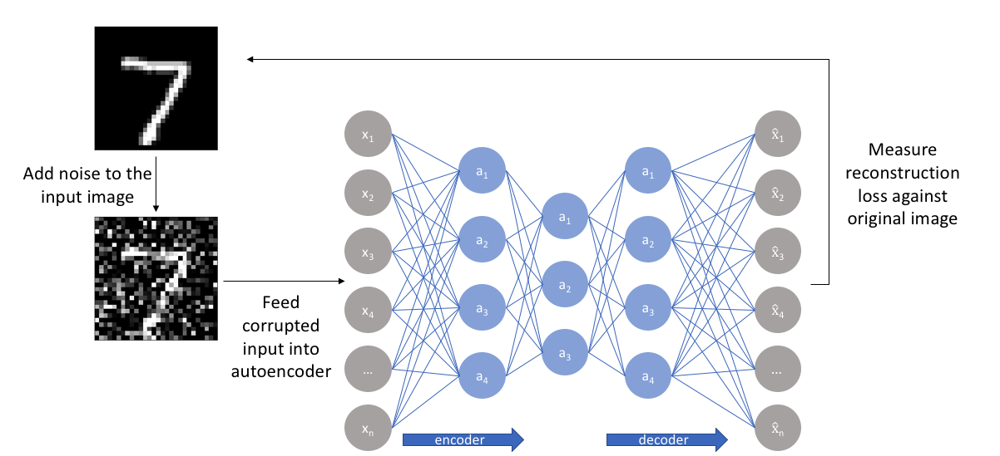

In [11]:
LAYERS = 3
KERNELS = [3, 3, 3]
CHANNELS = [32, 64, 128]
STRIDES = [2, 2, 2]
LINEAR_DIM = 2048

## AutoEncoder
Here we implement a mirrored encoder-decoder model

### Encoder

In [12]:
class Encoder(nn.Module):
    def __init__(self, output_dim=2, use_batchnorm=False, use_dropout=False):
        super(Encoder, self).__init__()

        # bottleneck dimensionality
        self.output_dim = output_dim

        self.use_dropout = use_dropout
        self.use_batchnorm = use_batchnorm

        # convolutional layer hyperparameters
        self.layers = LAYERS
        self.kernels = KERNELS
        self.channels = CHANNELS
        self.strides = STRIDES
        self.conv = self.get_convs()

        # layers for latent space projection
        # represent number of neurons in ful
        self.fc_dim = LINEAR_DIM # fully connectied dimension
        self.flatten = nn.Flatten()
        self.linear = nn.Linear(self.fc_dim, self.output_dim)

    def get_convs(self):
        """
        Generating convolutional layers based on model's hyperparams
        """
        conv_layers = nn.Sequential()
        for i in range(self.layers):
            # Input channel for first layer is 1
            if i==0:
                conv_layers.append(nn.Conv2d(1, self.channels[i],
                                         kernel_size=self.kernels[i],
                                         stride=self.strides[i],
                                         padding=1))
            else:
                conv_layers.append(nn.Conv2d(self.channels[i-1],self.channels[i],
                                             kernel_size=self.kernels[i],
                                             stride=self.strides[i],
                                             padding=1))
            if self.use_batchnorm:
                conv_layers.append(nn.BatchNorm2d(self.channels[i]))

            conv_layers.append(nn.GELU())

            if self.use_dropout:
                conv_layers.append(nn.Dropout2d(0.15))

        return conv_layers
    
    def forward(self, x):
        x=self.conv(x)
        x=self.flatten(x)
        return self.linear(x)

In [15]:
encoder = Encoder(use_batchnorm=True, use_dropout=True).to(DEVICE)
summary(encoder, (1, 32, 32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 16, 16]             320
       BatchNorm2d-2           [-1, 32, 16, 16]              64
              GELU-3           [-1, 32, 16, 16]               0
         Dropout2d-4           [-1, 32, 16, 16]               0
            Conv2d-5             [-1, 64, 8, 8]          18,496
       BatchNorm2d-6             [-1, 64, 8, 8]             128
              GELU-7             [-1, 64, 8, 8]               0
         Dropout2d-8             [-1, 64, 8, 8]               0
            Conv2d-9            [-1, 128, 4, 4]          73,856
      BatchNorm2d-10            [-1, 128, 4, 4]             256
             GELU-11            [-1, 128, 4, 4]               0
        Dropout2d-12            [-1, 128, 4, 4]               0
          Flatten-13                 [-1, 2048]               0
           Linear-14                   

### Decoder

In [54]:
class Decoder(nn.Module):
    def __init__(self, input_dim=2, use_batchnorm=False, use_dropout=False):
        super(Decoder, self).__init__()
        
        self.use_dropout=use_dropout
        self.use_batchnorm=use_batchnorm
        
        self.fc_dim=LINEAR_DIM
        self.input_dim=input_dim
        
        self.layers = LAYERS
        self.kernels = KERNELS
        self.channels = CHANNELS[::-1] # flip channel dim
        self.strides = STRIDES
        
        self.linear = nn.Linear(self.input_dim,self.fc_dim)
        self.conv = self.get_convs()
        
        self.output=nn.Conv2d(self.channels[-1], 1, kernel_size=1, stride=1)
        
    def get_convs(self):
        conv_layers = nn.Sequential()
        for i in range(self.layers):
            if i==0:
                conv_layers.append(nn.ConvTranspose2d(self.channels[i],
                                                     self.channels[i],
                                                     kernel_size=self.kernels[i],
                                                     stride=self.strides[i],
                                                     padding=1,
                                                     output_padding=1)
                                  )
            else:
                conv_layers.append(nn.ConvTranspose2d(self.channels[i-1],
                                                   self.channels[i],
                                                    kernel_size=self.kernels[i],
                                                    stride=self.strides[i],
                                                    padding=1,
                                                    output_padding=1
                                                   )
                                  )
            
            if self.use_batchnorm:
                conv_layers.append(nn.BatchNorm2d(self.channels[i]))
            
            conv_layers.append(nn.GELU())
            
            if self.use_dropout:
                conv_layers.append(nn.Dropout2d(0.15))
                
        return conv_layers
    
    def forward(self, x):
        x=self.linear(x)
        x=x.reshape(x.shape[0], 128, 4, 4)
        x=self.conv(x)
        return self.output(x)

In [55]:
decoder = Decoder(use_batchnorm=True, use_dropout=True).to(DEVICE)
summary(decoder, (1, 2))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1              [-1, 1, 2048]           6,144
   ConvTranspose2d-2            [-1, 128, 8, 8]         147,584
       BatchNorm2d-3            [-1, 128, 8, 8]             256
              GELU-4            [-1, 128, 8, 8]               0
         Dropout2d-5            [-1, 128, 8, 8]               0
   ConvTranspose2d-6           [-1, 64, 16, 16]          73,792
       BatchNorm2d-7           [-1, 64, 16, 16]             128
              GELU-8           [-1, 64, 16, 16]               0
         Dropout2d-9           [-1, 64, 16, 16]               0
  ConvTranspose2d-10           [-1, 32, 32, 32]          18,464
      BatchNorm2d-11           [-1, 32, 32, 32]              64
             GELU-12           [-1, 32, 32, 32]               0
        Dropout2d-13           [-1, 32, 32, 32]               0
           Conv2d-14            [-1, 1,

### AutoEncoder

In [56]:
class AutoEncoder(nn.Module):
    def __init__(self):
        super(AutoEncoder, self).__init__()
        self.encoder = Encoder(output_dim=2, use_batchnorm=True, use_dropout=False)
        self.decoder = Decoder(input_dim=2, use_batchnorm=True, use_dropout=False)
        
    def forward(self, x):
        return self.decoder(self.encoder(x))

In [57]:
model=AutoEncoder().to(DEVICE)
summary(model, (1, 32, 32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 16, 16]             320
       BatchNorm2d-2           [-1, 32, 16, 16]              64
              GELU-3           [-1, 32, 16, 16]               0
            Conv2d-4             [-1, 64, 8, 8]          18,496
       BatchNorm2d-5             [-1, 64, 8, 8]             128
              GELU-6             [-1, 64, 8, 8]               0
            Conv2d-7            [-1, 128, 4, 4]          73,856
       BatchNorm2d-8            [-1, 128, 4, 4]             256
              GELU-9            [-1, 128, 4, 4]               0
          Flatten-10                 [-1, 2048]               0
           Linear-11                    [-1, 2]           4,098
          Encoder-12                    [-1, 2]               0
           Linear-13                 [-1, 2048]           6,144
  ConvTranspose2d-14            [-1, 12

In [58]:
# visualize latent space
def plotting(step:int=0, show=False):
    model.eval()
    
    points=[]
    label_idcs=[]
    
#     Save plot 
#     path='./ScatterPlots'
#     if not os.path.exists(path): os.mkdir(path)
    
    for i, data in enumerate(valid_loader):
        img, label = [d.to(DEVICE) for d in data]
        proj = model.encoder(img)
#         What is proj.shape?
        points.extend(proj.detach().cpu().numpy())
        label_idcs.extend(label.detach().cpu().numpy())
#         delete img, label to avoid out of memory
        del img, label
    
    points=np.array(points)
#     create scatter plot
    fig, ax = plt.subplots(figsize=(10, 10) if not show else (8, 8))
#     define scatter which is image 2D projection
    scatter=ax.scatter(x=points[:,0],y=points[:,1],s=2.0,c=label_idcs,cmap='tab10',alpha=0.9,zorder=2)
    
#     turn off right and top line
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    
    ax.grid(True, color='lightgray',alpha=1,zorder=0)
    plt.show()
    
# convert image sequence into gif file
def save_gif():
    frames=[]
    imgs=sorted(os.listdir("./ScatterPlots"))
    pass

## Experiment

In [59]:
# loss function
criterion=nn.MSELoss()
optimizer=torch.optim.AdamW(model.parameters(),lr=lr,weight_decay=1e-5)

# For mixed precision training?
scaler=torch.amp.GradScaler()
steps=0 #track training steps

In [60]:
def train(model, dataloader, criterion, optimizer, save_distrib=False):
    global steps
    
    model.train()
    train_loss=0.0
    
#     Process tdqm bar for monitoring training progress
    batch_bar = tqdm(total=len(dataloader),dynamic_ncols=True,leave=False,position=0,desc='Train')
    
    for i, batch in enumerate(dataloader):
        optimizer.zero_grad()
        x=batch[0].to(DEVICE)
        
#         implement mixed precision training
        with torch.cuda.amp.autocast():
#         reconstructed image
            y_recons=model(x)
            loss=criterion(y_recons, x)
    
        train_loss+=loss.item()
        
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        
        batch_bar.set_postfix(
            loss=f"{train_loss/(i+1):.4f}",
            lr=f"{optimizer.param_groups[0]['lr']:.4f}"
        )
        
        batch_bar.update()
        
        if steps%10==0 and save_distrib and steps<=400:
            plotting(steps)
        steps+=1
        
#         removing cache
        torch.cuda.empty_cache()
        del x, y_recons
        
    batch_bar.close()
    train_loss/=len(dataloader)
    
    return train_loss

In [61]:
def validate(model, dataloader, criterion):
    model.eval()
    valid_loss=0.0 
    
    batch_bar=tqdm(total=len(dataloader),dynamic_ncols=True,leave=False,position=0,desc='Validation')
    
    for i, batch in enumerate(dataloader):
        x=batch[0].to(DEVICE)
        
        with torch.no_grad():
            y_recons = model(x)
            loss = criterion(y_recons, x)
            
        valid_loss+=loss.item()
        
        batch_bar.set_postfix(
            loss=f"{valid_loss/(i+1):.4f}",
            lr=f"{optimizer.param_groups[0]['lr']:.4f}"
        )
        batch_bar.update()
        
        torch.cuda.empty_cache()
        del x, y_recons
        
    batch_bar.close()
    valid_loss/=len(dataloader)
    
    return valid_loss

Train:   0%|          | 0/938 [00:00<?, ?it/s]

/tmp/ipykernel_36/55823711.py:15: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


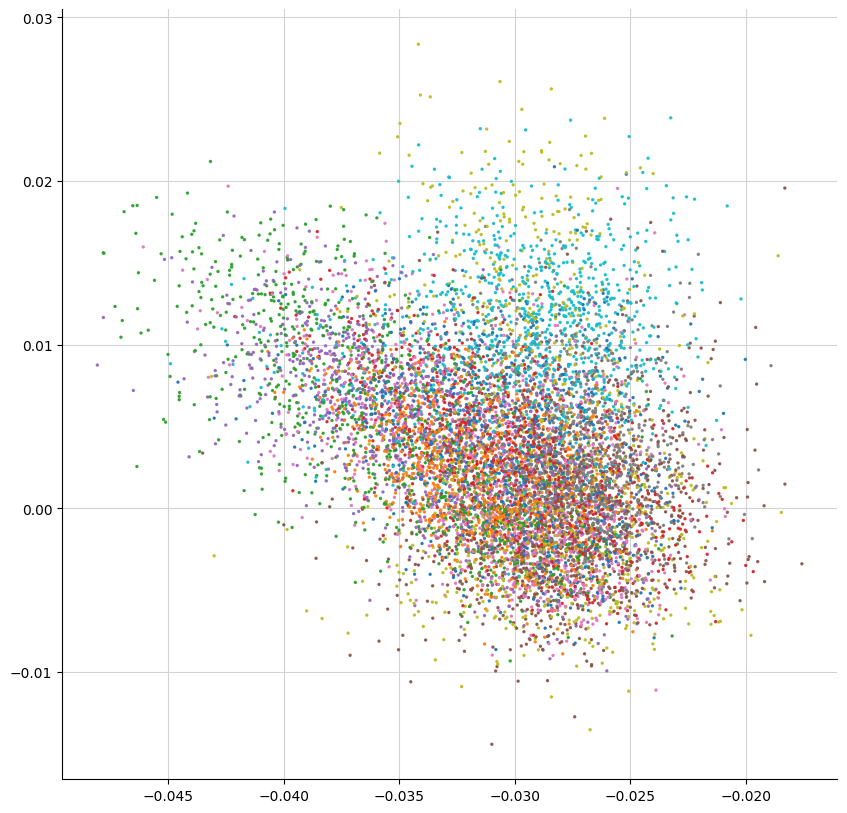

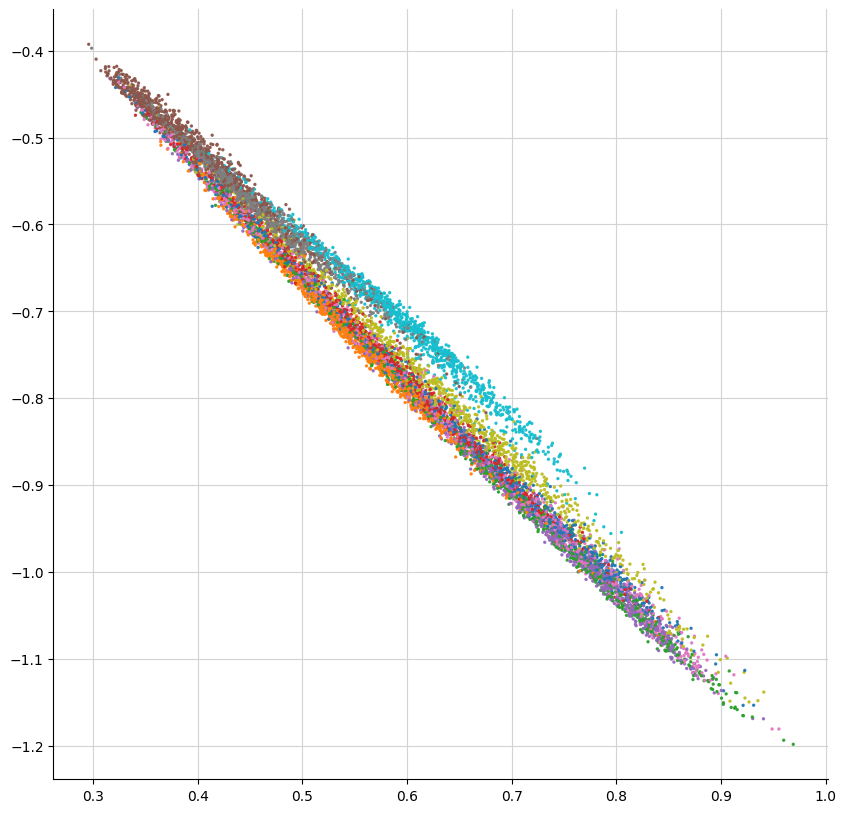

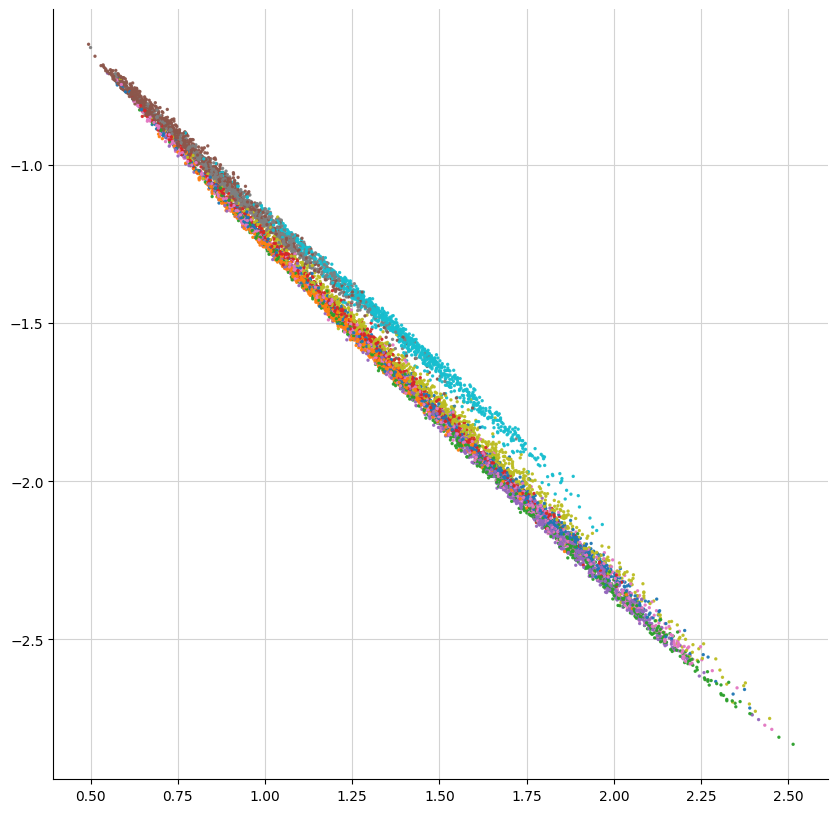

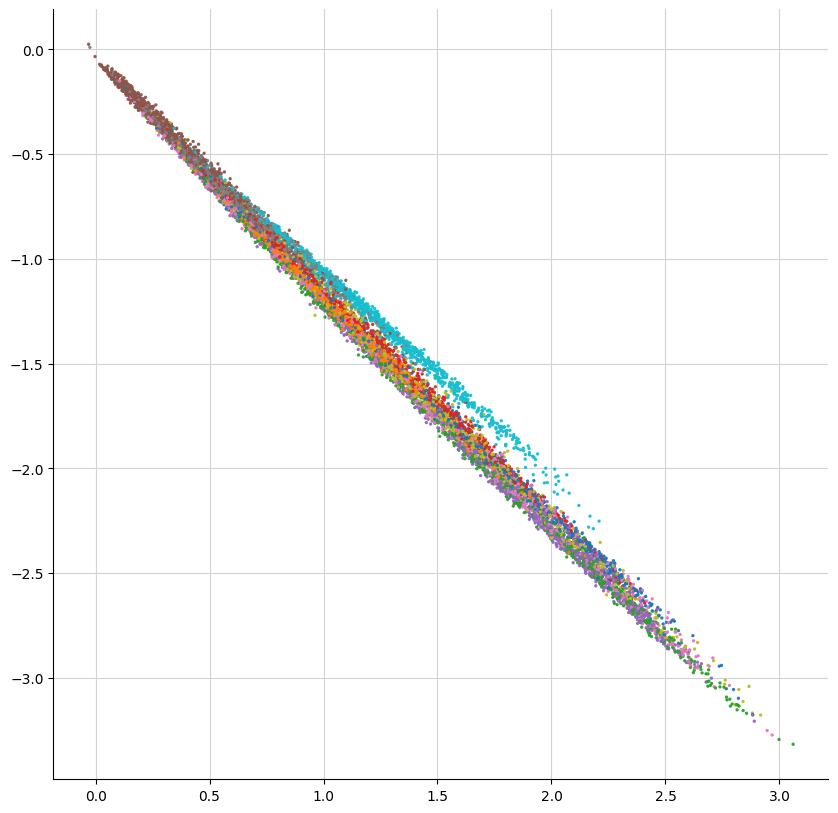

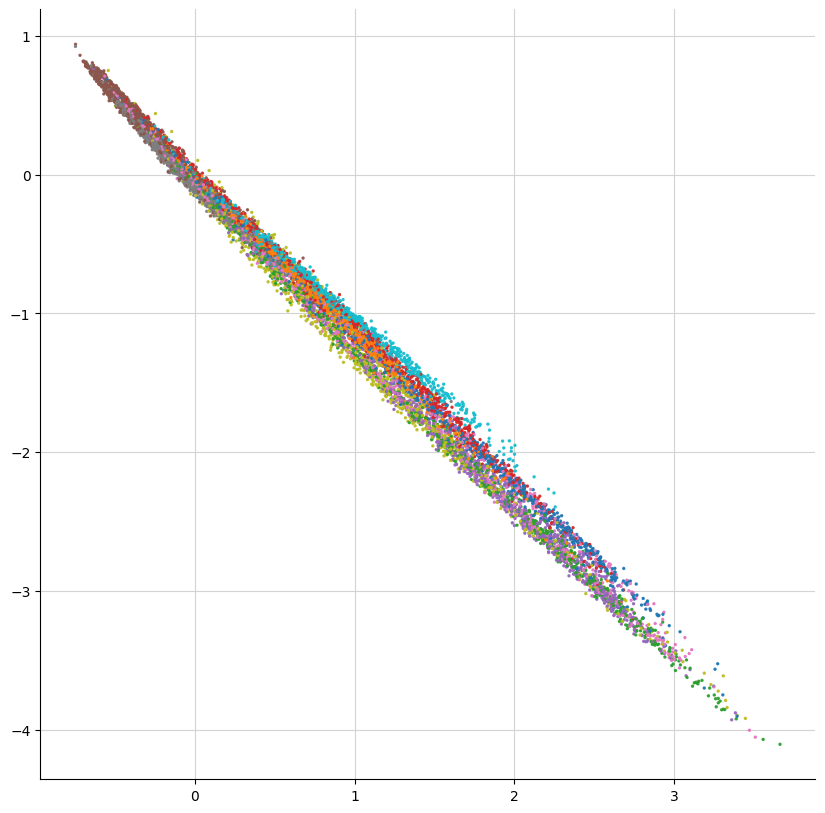

...

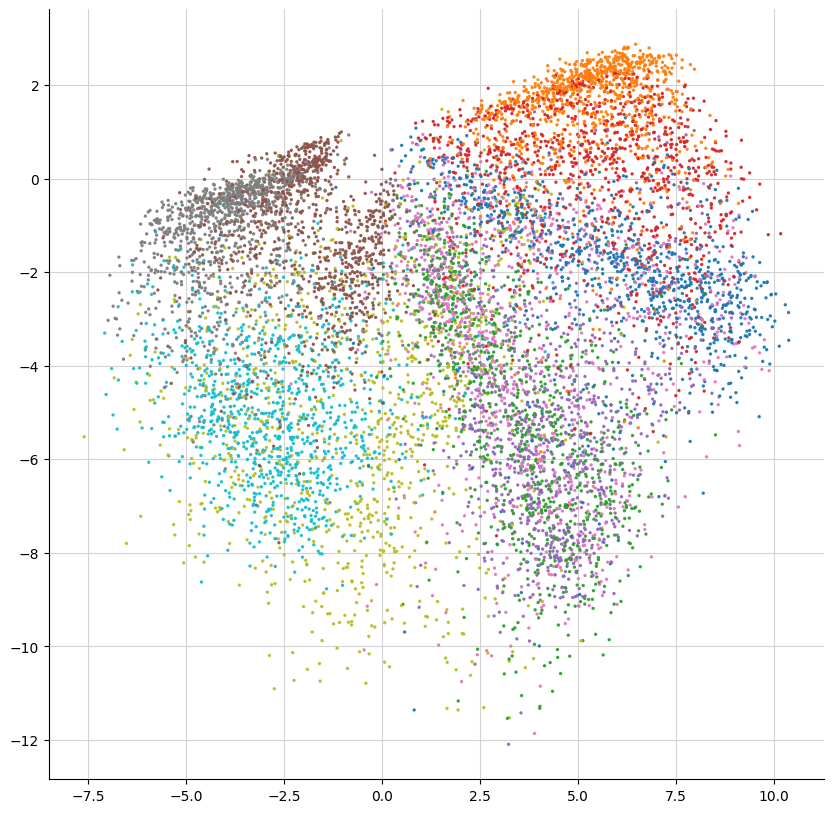

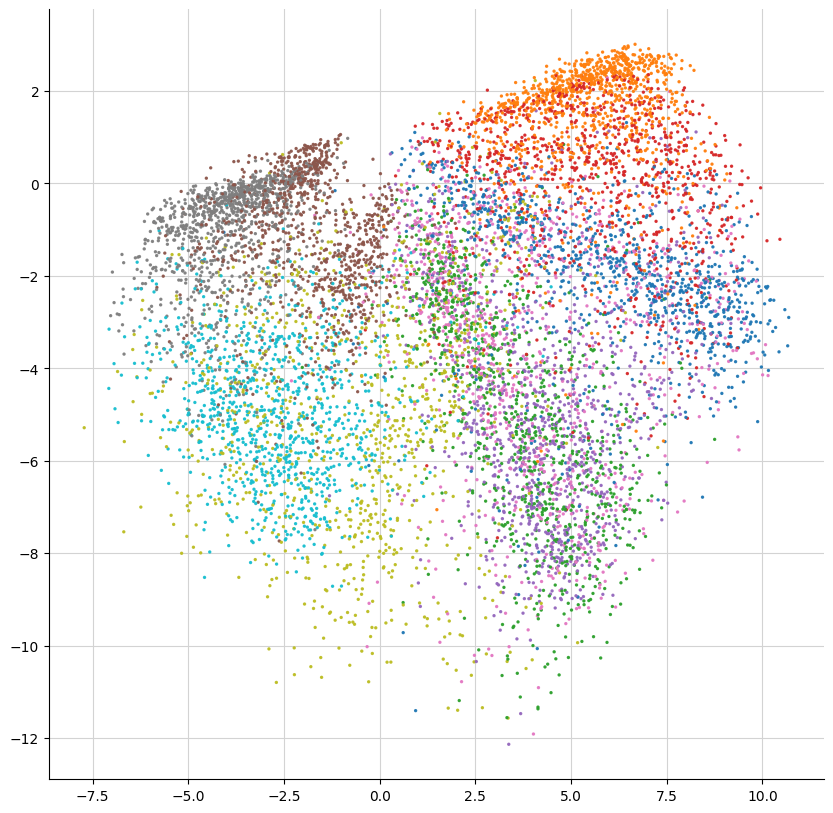

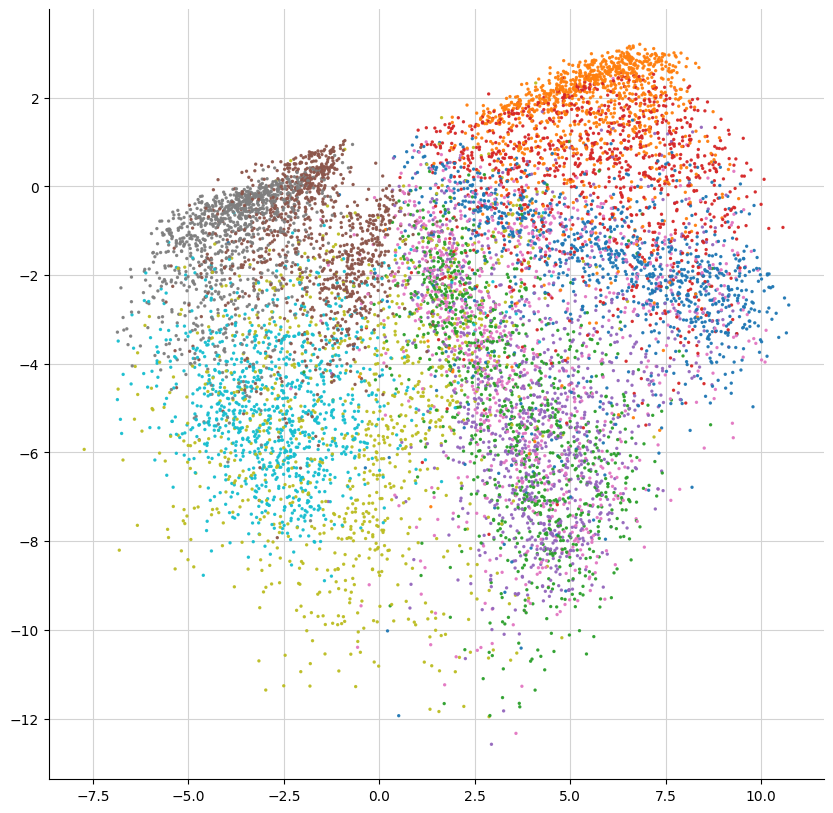

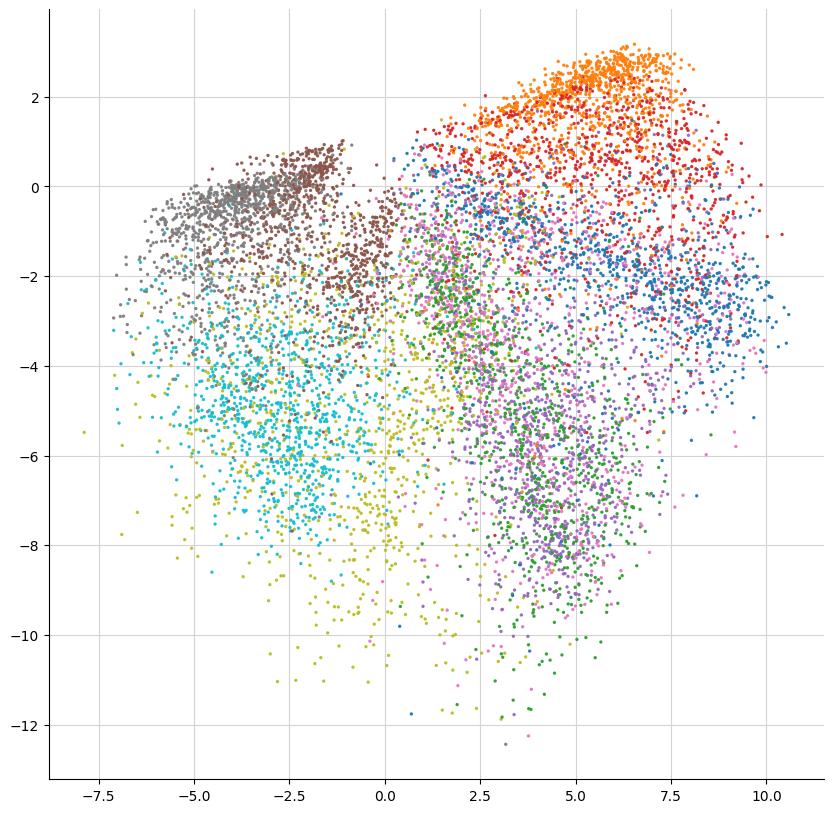

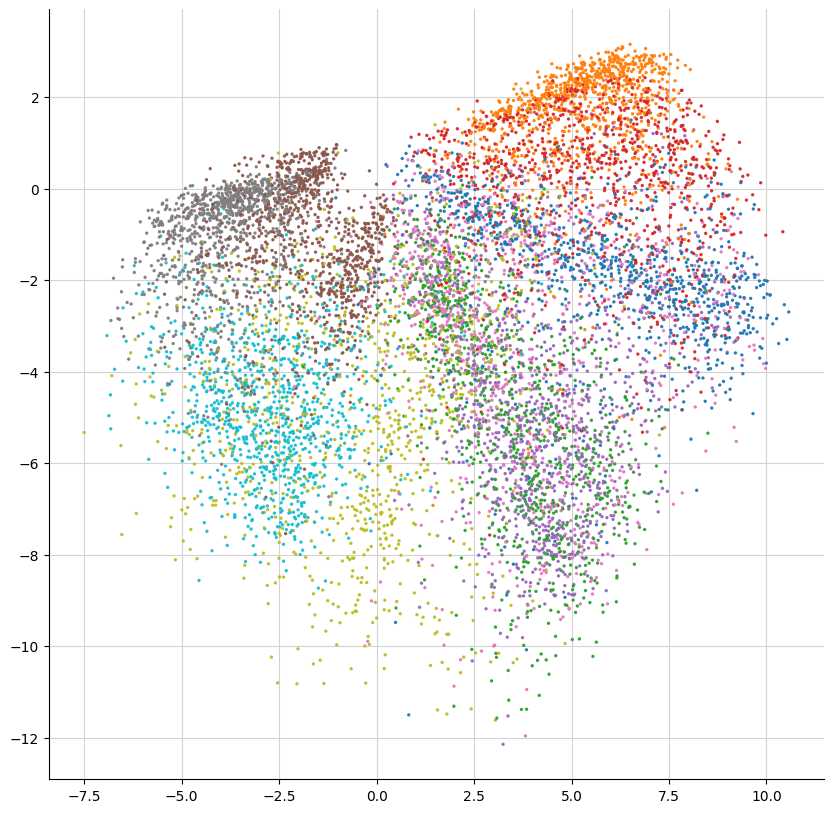

Validation:   0%|          | 0/157 [00:00<?, ?it/s]

Epoch 1/EPOCHS 
Train loss: 0.0321	 Validation loss: 0.0247	lr: 0.0005


Train:   0%|          | 0/938 [00:00<?, ?it/s]

Validation:   0%|          | 0/157 [00:00<?, ?it/s]

Epoch 2/EPOCHS 
Train loss: 0.0293	 Validation loss: 0.0243	lr: 0.0005


Train:   0%|          | 0/938 [00:00<?, ?it/s]

Validation:   0%|          | 0/157 [00:00<?, ?it/s]

Epoch 3/EPOCHS 
Train loss: 0.0243	 Validation loss: 0.0236	lr: 0.0005


In [64]:
for i in range(EPOCHS):
    curr_lr=float(optimizer.param_groups[0]['lr'])
    train_loss=train(model, train_loader,criterion, optimizer,save_distrib=True)
    valid_loss=validate(model,valid_loader,criterion)
    
    print(f"Epoch {i+1}/EPOCHS \nTrain loss: {train_loss:.4f}\t Validation loss: {valid_loss:.4f}\tlr: {curr_lr:.4f}")

In [ ]:
# randomly sample x and y values
xs = [random.uniform(-6.0, 8.0) for i in range(8)]
ys = [random.uniform(-7.5, 10.0) for i in range(8)]

points = list(zip(xs, ys))
coords = torch.tensor(points).unsqueeze(1).to(DEVICE)

nrows, ncols = 2, 4
fig, axes = plt.subplots(nrows, ncols, figsize=(10, 5))

model.eval()
with torch.no_grad():
    generates = [model.decoder(coord) for coord in coords]

# plot points
idx = 0
for row in range(0, nrows):
    for col in range(0, ncols):
        ax = axes[row, col]
        im = generates[idx].squeeze().detach().cpu()
        ax.imshow(im, cmap="gray")
        ax.axis("off")
        coord = coords[idx].detach().cpu().numpy()[0]
        ax.set_title(f"({coord[0]:.3f}, {coord[1]:.3f})")
        idx += 1
plt.show()